# Машинное обучение, ФКН ВШЭ

# Практическое задание 10. Обучение без учителя.

## Общая информация
Дата выдачи: 23.03.2022

Мягкий дедлайн: 06.04.2022 23:59 MSK

Жёсткий дедлайн: 10.04.2022 23:59 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу — 10 баллов.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-10-Username.ipynb

Username — ваша фамилия на латинице

## О задании

В этом задании мы посмотрим на несколько алгоритмов кластеризации и применим их к географическим и текстовым данным. Также мы подробно остановимся на тематическом моделировании текстов, задаче обучения представлений и в каком-то смысле поработаем с semi-supervised learning. 



In [1]:
import pandas as pd
import numpy as np

np.random.seed(0xFFFFFFF)

**Задание 0 (1e-100 балла)**. Опишите свои ощущения от домашки по ЕМ-алгоритму (можно картинкой или мемом).

In [2]:
# YOUR CODE HERE (ノಠ益ಠ)ノ彡┻━┻
# @#$%^&*$#@#$%^&*

## Часть 1. Кластеризация автобусных остановок

В этом задании мы сравним разные алгоритмы кластеризации для данных об автобусных остановках Москвы.

**Задание 1.1 (1 балл).** Реализуйте алгоритм спектральной кластеризации, который упоминался на лекции. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Напомним, что для графа с матрицей смежности $W = \{w_{ij}\}_{i, j = 1 \dots \ell}$ лапласиан определяется как:

$$
L = D - W,
$$

где $D = \text{diag}(d_1, ..., d_{\ell}), d_i = \sum_{j=1}^{\ell} w_{ij}$.

In [3]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''
        D = np.diag(np.sum(X,axis=1))
        L = (D - X)
        vals, vecs = np.linalg.eig(L)
        vecs = vecs[:,np.argsort(vals)]
        vecs = abs(vecs[:,:self.n_components])
        return vecs

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [4]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

Теперь можем приступить к работе с реальными данными. Скачайте файл с данными об остановках общественного транспорта **в формате .xlsx** по [ссылке](https://data.mos.ru/opendata/download/60464/1/201) (так гарантированно не возникнет проблем с парсингом файла) и загрузите таблицу в ноутбук. Если вдруг сайт Правительства Москвы сойдет с ума, то возьмите какую-нибудь версию данных [отсюда](https://data.mos.ru/opendata/7704786030-city-surface-public-transport-stops). Для удобства визуализации мы будем работать только с остановками в ЦАО.

In [5]:
data = pd.read_excel('/content/transport.xlsx')
data = data[data.AdmArea_en == "Czentral`ny'j administrativny'j okrug"]
data = data.reset_index()
data.head()

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
0,278,347,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
1,279,349,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
2,355,479,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN
3,356,480,"«Спортзал Дружба», Лужнецкая набережная (480)",37.570191,55.712504,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Спортзал Дружба,NaN,да,ГУП «Мосгортранс»,active,889085550,NaN
4,357,481,"«Лужнецкая наб.», Лужнецкая набережная (481)",37.574559,55.713770,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Лужнецкая наб.,NaN,да,ГУП «Мосгортранс»,active,889085551,NaN


Воспользуемся библиотекой `folium` для визуализации данных.

In [6]:
import folium

map = folium.Map([55.75215, 37.61819], zoom_start=12)
for id, row in data.iterrows():
    folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10).add_to(map)
map

**Задание 1.2 (1 балл).** Попробуем построить граф, в котором вершинами будут остановки. Как вы уже могли заметить, для каждой остановки указаны номера маршрутов, проходящих через неё. Логично соединить ребрами соседние остановки каждого маршрута. Однако мы не знаем, в каком порядке автобусы объезжают остановки. Но мы можем применить эвристический алгоритм, который восстановит нам порядок маршрутов:

* Для каждого маршрута выделим список всех остановок, через которые он проходит.
* Выберем начальную остановку маршрута как точку, наиболее удаленную от всех остальных остановок этого маршрута.
* Каждую следующую точку маршрута будем выбирать как самую близкую из оставшихся точек (не включенных в маршрут ранее).

Фактически, у нас получается жадное решение задачи коммивояжера. Когда мы отсортировали маршруты, можем построить по ним граф. Будем строить его по таким правилам:

* Между двумя остановками будет ребро, если они являются соседними хотя бы на одном маршруте. Вес ребра равен числу маршрутов, на которых остановки являются соседними.
* В графе не будет петель (то есть у матрицы смежности будет нулевая диагональ).

Реализуйте предложенный способ построения графа. Для этого рекомендуется воспользоваться шаблонами, приведенными ниже.

Источник: 
https://stackoverflow.com/questions/4913349/haversine-formula-in-python-bearing-and-distance-between-two-gps-points

In [7]:
from numpy import radians, cos, sin, arcsin, sqrt
def haversine(lon1, lat1, lon2, lat2):
    lon1 = np.radians(lon1)
    lat1 = np.radians(lat1)
    lon2 = np.radians(lon2)
    lat2 = np.radians(lat2)
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * arcsin(sqrt(a))
    r = 6371
    return c * r

In [8]:
def get_routes(data):
    '''
    Accumulate routes from raw data
    param data: pd.DataFrame - public transport stops data
    return: dict - unsorted stops ids for each route,
                   e.g. routes['A1'] = [356, 641, 190]
    '''

    routes = {}
    route = list(set('; '.join(data['RouteNumbers_en']).split('; ')))
    check = data['RouteNumbers_en'].apply(lambda x: x.split('; '))
    for r in route:
        routes[r] = list(data[check.apply(lambda x: r in x)].index)
    return routes
def sort_routes(data, routes):
    '''
    Sort routes according to the proposed algorithm
    param data: pd.DataFrame - public transport stops data
    param routes: dict - unsorted stops ids for each route
    return: dict - sorted stops ids for each route
    '''
    sort_routes = {}
    for route in routes.keys():
        sort_routes[route] = []
        lis=[]
        id_ = routes[route]
        dist = data.iloc[id_][['Longitude_WGS84_en','Latitude_WGS84_en']]
        dist['key'] = 1
        ar = np.array(dist.merge(dist, on = 'key', how = 'outer').drop('key',axis=1))
        hd = haversine(ar[:,0],ar[:,1],ar[:,2],ar[:,3]).reshape(len(dist),len(dist))
        value = np.argmax(hd.sum(axis=1))
        lis.append(value)
        sort_routes[route].append(routes[route][value])
        for i in range(len(hd)-1):
          hd[value][lis] = np.inf
          value = np.argmin(hd[value])
          lis.append(value)
          sort_routes[route].append(routes[route][value])
    return sort_routes


def get_adjacency_matrix(data, sorted_routes):
    '''
    Compute adjacency matrix for sorted routes
    param data: pd.DataFrame - public transport stops data
    param sorted_routes: dict - sorted stops ids for each route
    return: (n_samples, n_samples) - graph adjacency matrix
    '''
    graph_matrix = np.zeros((len(data),len(data)))
    for route in sorted_routes:
        if len(sorted_routes[route])>1:
            he = tuple(np.array_split(np.delete(np.repeat(sorted_routes[route], 2),[0,-1]),len(sorted_routes[route])-1))
            ha = tuple(np.array_split(np.delete(np.repeat(sorted_routes[route], 2)[::-1],[0,-1]),len(sorted_routes[route])-1))
            graph_matrix[np.array(he)[:,0],np.array(he)[:,1]]+=1
            graph_matrix[np.array(ha)[:,0],np.array(ha)[:,1]]+=1
    return graph_matrix

In [9]:
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)

Проверим, что маршруты получились адекватными. Для этого нарисуем их на карте.

In [10]:
map = folium.Map([55.75215, 37.61819], zoom_start=12)
for route_id in np.random.choice(list(sorted_routes.keys()), size=5):
    coords = data.loc[
        sorted_routes[route_id],
        ['Latitude_WGS84_en', 'Longitude_WGS84_en']
    ].values.tolist()
    folium.vector_layers.PolyLine(coords).add_to(map)
map

**Задание 1.3 (0 баллов)**. Реализуйте функцию `draw_clustered_map`, которая рисует карту центра Москвы с кластерами остановок, раскрашенными в разные цвета.

In [11]:
import seaborn as sns

In [12]:
def draw_clustered_map(data, labels):
    '''
    Create map with coloured clusters
    param data: pd.DataFrame - public transport stops data
    param labels: (n_samples, ) - cluster labels for each stop
    return: folium.Map - map with coloured clusters
    '''
    lab_un = list(set(labels))
    color = {}
    palette = sns.color_palette("Spectral", len(lab_un)).as_hex()
    for i in range(len(lab_un)):
        color[lab_un[i]]=palette[i]
    map = folium.Map([55.75215, 37.61819], zoom_start=12)
    for j in range(len(data)):
        folium.CircleMarker(
            location=[data.iloc[j]['Latitude_WGS84_en'],data.iloc[j]['Longitude_WGS84_en']],
            radius=5,
            color=color[labels[j]],
            fill_color=color[labels[j]],
        ).add_to(map)
    return map

**Задание 1.4 (1.5 балла)**. Примените алгоритмы кластеризации K-Means и DBSCAN из `sklearn` на координатах остановок, а также свою реализацию спектральной кластеризации на построенной выше матрице смежности. Визуализируйте результат кластеризации с помощью функции `draw_clustered_map`. Подберите параметры алгоритмов (`n_clusters` у K-Means, `eps` у DBSCAN, `n_clusters` и `n_components` у спектральной кластеризации) так, чтобы получить наиболее характерный для этих алгоритмов результат кластеризации (можете поэкспериментировать и оставить в ноутбуке картинки только для итоговых значений параметров, также обратите внимание на баланс объектов в кластерах). Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [13]:
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans

K-means

In [14]:
km = KMeans(n_clusters = 60).fit(data[['Latitude_WGS84_en','Longitude_WGS84_en']])

In [15]:
draw_clustered_map(data, km.labels_)

DBSCAN

In [16]:
dbscan = DBSCAN(eps= 0.0019).fit(data[['Latitude_WGS84_en','Longitude_WGS84_en']])

In [17]:
draw_clustered_map(data, dbscan.labels_)

Спектральная кластеризация

In [18]:
graph_clustering = GraphClustering(n_clusters=60, n_components=1000)
labels = graph_clustering.fit_predict(adjacency_matrix)

In [19]:
draw_clustered_map(data, labels)

Проинтерпретируйте полученные результаты. Чем отличаются разбиения на кластеры, получаемые разными алгоритмами? Какие плюсы и минусы есть у каждого алгоритма? Какой алгоритм кажется вам наиболее подходящим для кластеризации остановок?

**Ответ:**

DBSCAN плохо работает здесь в принципе,относя абсолютное большинство остановок к одному маршруту; у kmeans кластеры поолучились больше облачными, что вряд ли интерпретируемо как маршруты, тогда как спектральная кластеризация выдает результат, наиболее похожий на реалность (маршруты вытянуты вдоль дорог, "цепочкой")

## Часть 2. Тематическое моделирование текстов

В этой части мы познакомимся с одной из самых популярных задач обучения без учителя &mdash; с задачей тематического моделирования текстов. Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. Фактически, мы будем решать задачу, похожую на кластеризацию текстов: отличие в том, что нас будет интересовать не только разбиение текстов на группы, но и выделение ключевых слов, определяющих каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [20]:
data = pd.read_csv('/content/bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
652,entertainment,143.txt,Blair buys copies of new Band Aid,Prime Minister Tony Blair purchased two copie...
1003,politics,108.txt,'Super union' merger plan touted,Two of Britain's big trade unions could merge...
1663,sport,351.txt,Teenager Tait picked for England,Newcastle's teenage centre Mathew Tait has be...
727,entertainment,218.txt,Stern dropped from radio stations,Controversial DJ Howard Stern has been droppe...
589,entertainment,080.txt,US TV cuts nudity from BBC film,A US TV network is editing BBC Films' Dirty W...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [21]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [22]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'])
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [23]:
def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

In [24]:
data['raw_text'] = data.apply(lambda row: row.title + row.content, axis=1)
data['text'] = data.apply(lambda row: preprocess(row.raw_text), axis=1)

Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [25]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)
    
    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

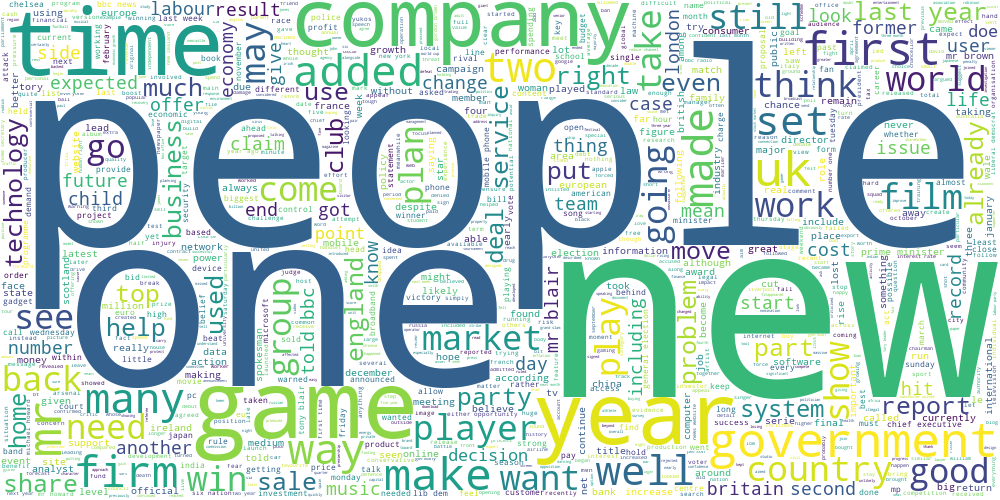

In [26]:
draw_wordcloud(data.text)

**Задание 2.1 (1 балл).** Обучите алгоритм K-Means на tf-idf представлениях текстов. При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова, а также воздержитесь от использования N-грамм. Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8). Постройте облака тегов для текстов из разных кластеров. Получились ли темы интерпретируемыми? Попробуйте озаглавить каждую тему.

**Ответ:**

In [27]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [28]:
vectorizer = TfidfVectorizer()
X = vectorizer.fit_transform(data['text'])

In [29]:
kmeans = KMeans(n_clusters = 6, random_state=0).fit(X)

In [30]:
data['kmeans']=kmeans.labels_

label:  0


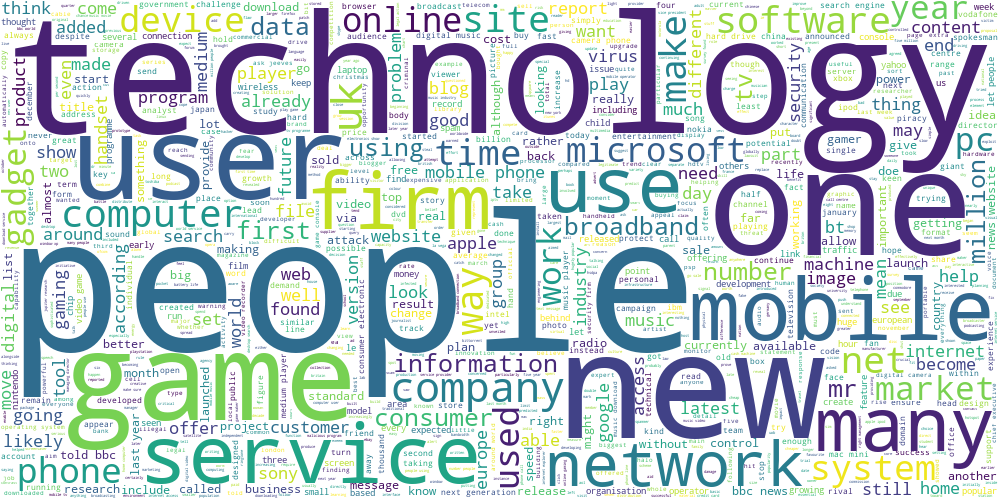

label:  1


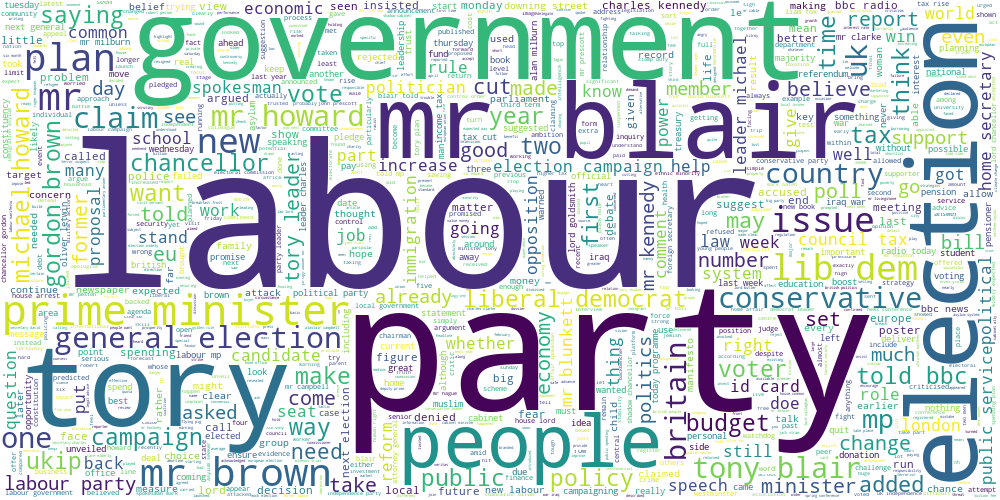

label:  2


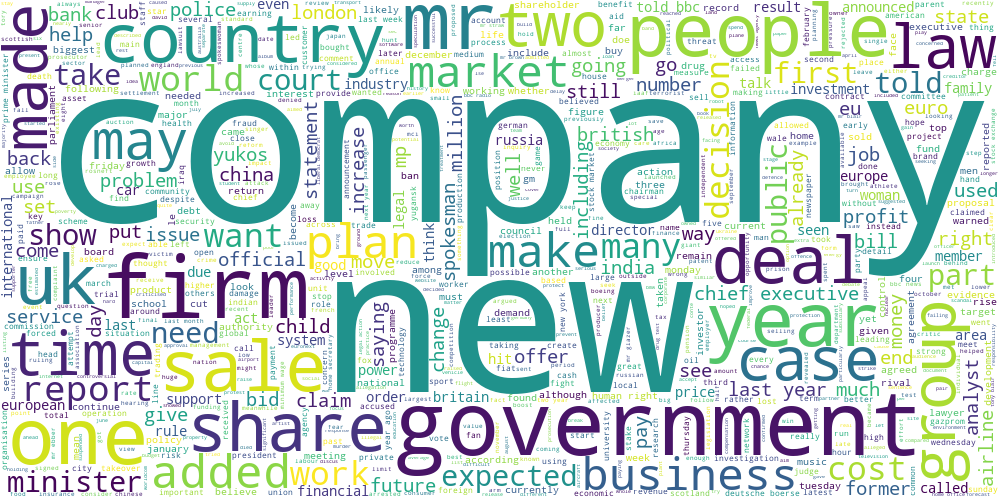

label:  3


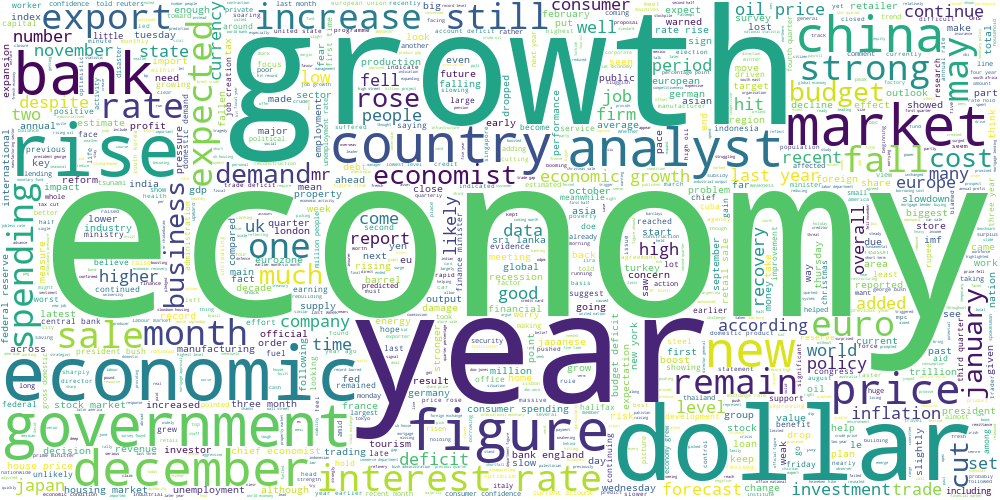

label:  4


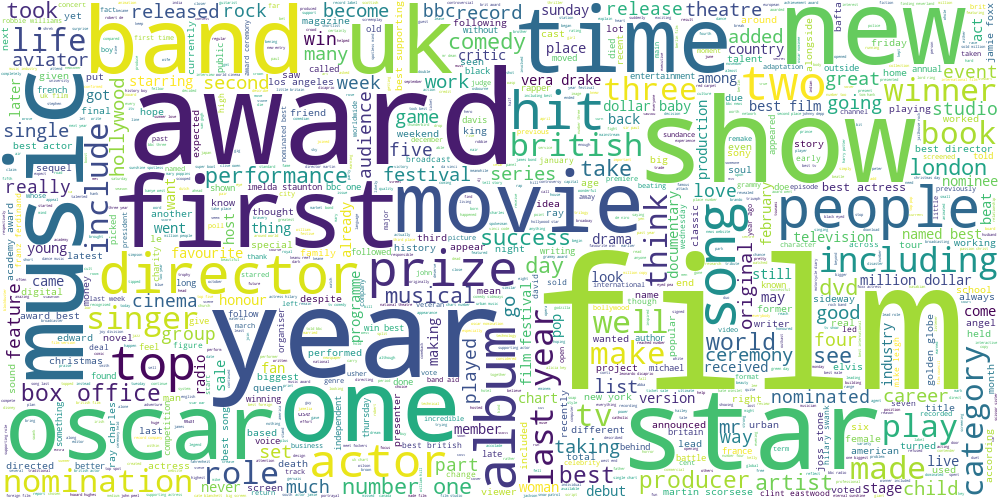

label:  5


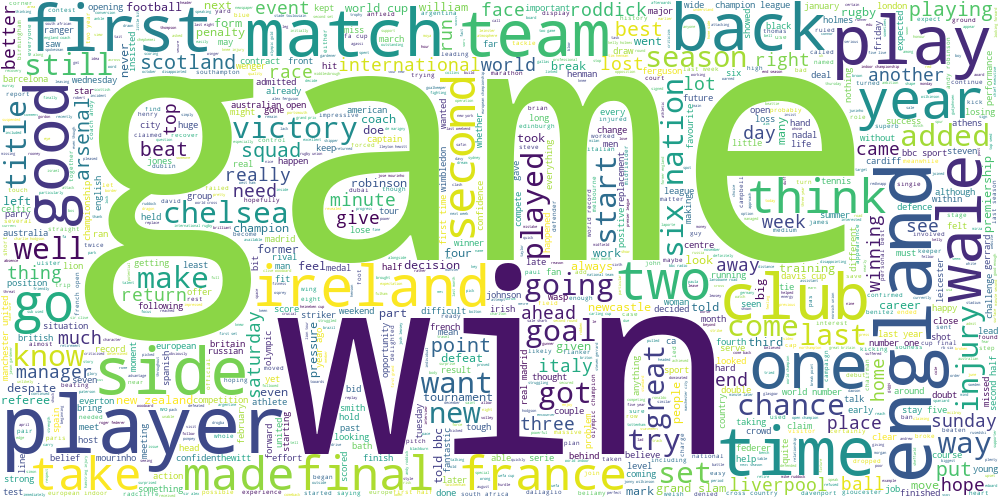

In [31]:
for i in list(set(data['kmeans'])):
  df = data[data['kmeans']==i]
  print('label: ', i)
  display(draw_wordcloud(df.text))

label 0: технологии

label 1: политика 

label 2: бизнес

label 3: экономика/бизнес

label 4: развлечения

label 5: спорт

**Задание 2.2 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. Попробуйте взять центры кластеров и посмотреть на слова, для которых значения соответствующих им признаков максимальны. Согласуются ли полученные слова с облаками тегов из прошлого задания?

**Ответ:** 

В целом, ключевые слова согласуются с облаками тегов из прошлого задания

In [32]:
from scipy import sparse

In [33]:
centr = kmeans.cluster_centers_
words = vectorizer.inverse_transform(sparse.csr_matrix(centr))

label:  0


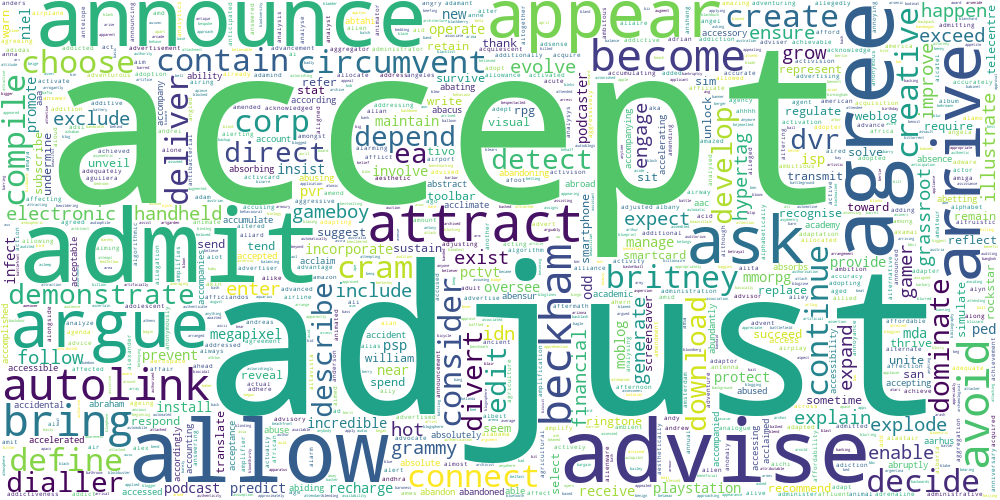

label:  1


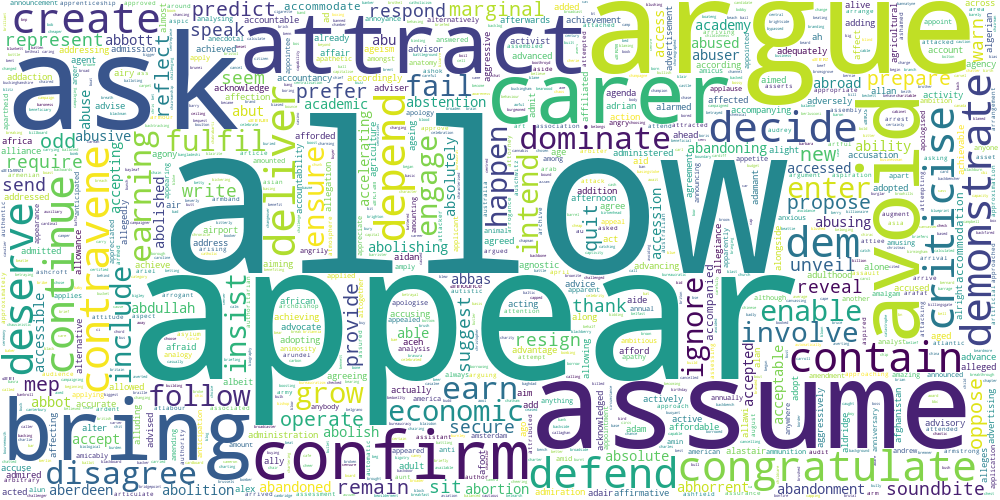

label:  2


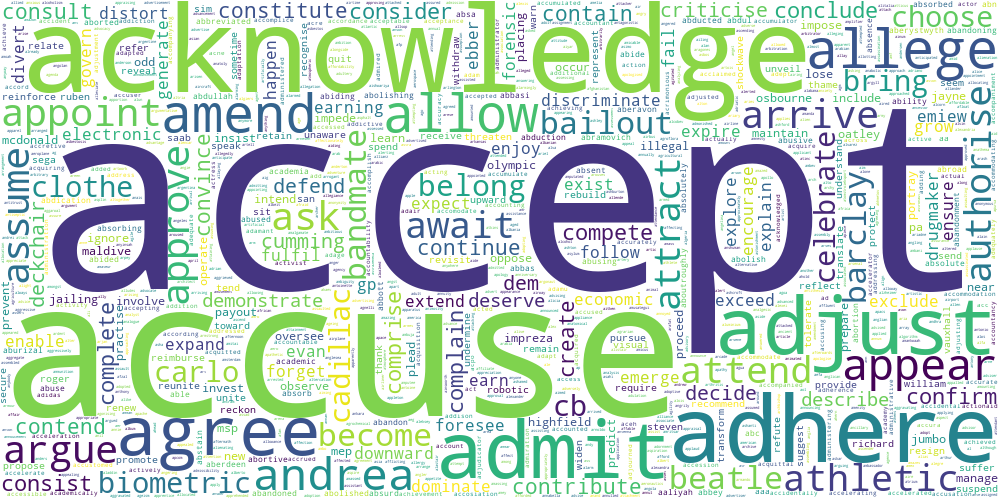

label:  3


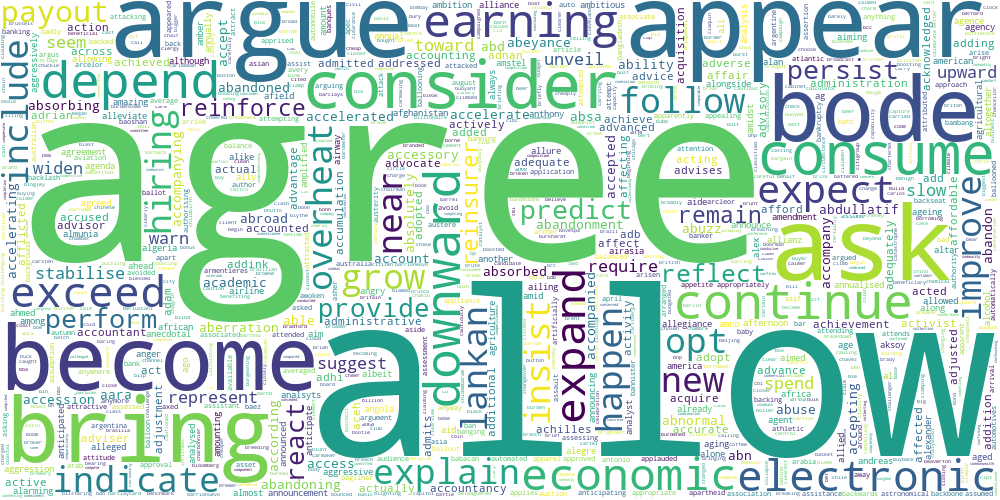

label:  4


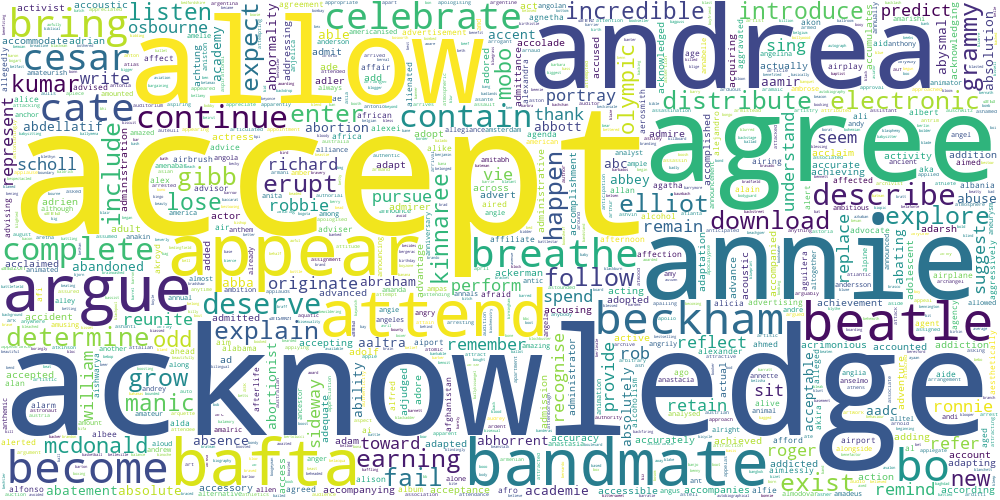

label:  5


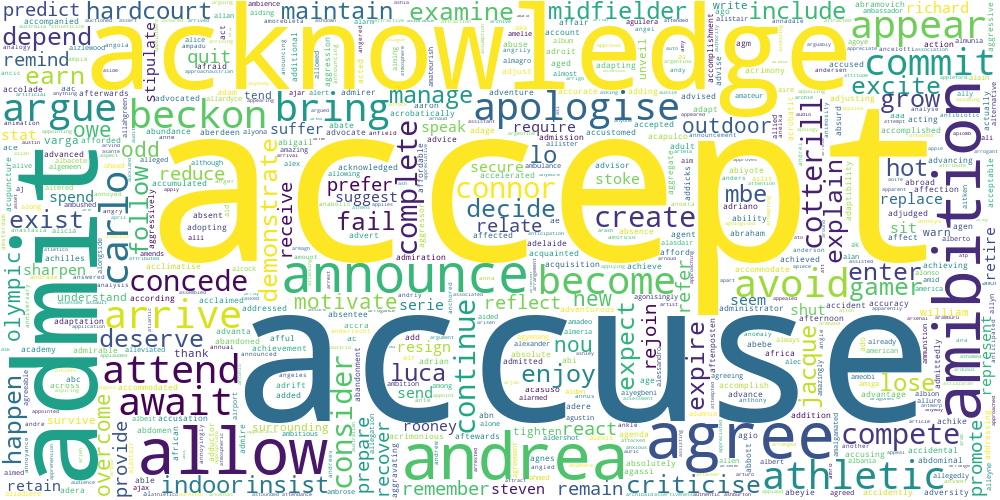

In [34]:
for i in range(6): 
  print('label: ',i)
  display(draw_wordcloud(words[i]))

В целом, результат согласуется с предыдущим

**Задание 2.3 (1.5 балла).** В первой части мы сравнили три разных алгоритма кластеризации на географических данных. Проделаем то же самое для текстовых данных (в качестве признакого описания снова используем tf-idf). Получите три разбиения на кластеры с помощью алгоритмов K-Means, DBSCAN и спектральной кластеризации (на этот раз воспользуйтесь реализацией из `sklearn`). Для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров, подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.

Далее, обучите двухмерные t-SNE представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом. Лучше всего расположить визуализации на одном графике на трех разных сабплотах. Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [35]:
from sklearn.cluster import SpectralClustering

In [36]:
kmeans = KMeans(n_clusters = 6, random_state=0).fit(X).labels_

In [37]:
dbscan = DBSCAN(eps=1.27).fit(X).labels_

In [38]:
spec = SpectralClustering(n_clusters=6).fit(X).labels_

In [39]:
from sklearn.manifold import TSNE
import seaborn as sns
import matplotlib.pyplot as plt

In [40]:
tsne = TSNE().fit_transform(X)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


In [41]:
df = pd.DataFrame(tsne)

In [42]:
df['kmeans'] = kmeans
df['dbscan'] = dbscan
df['spec'] = spec

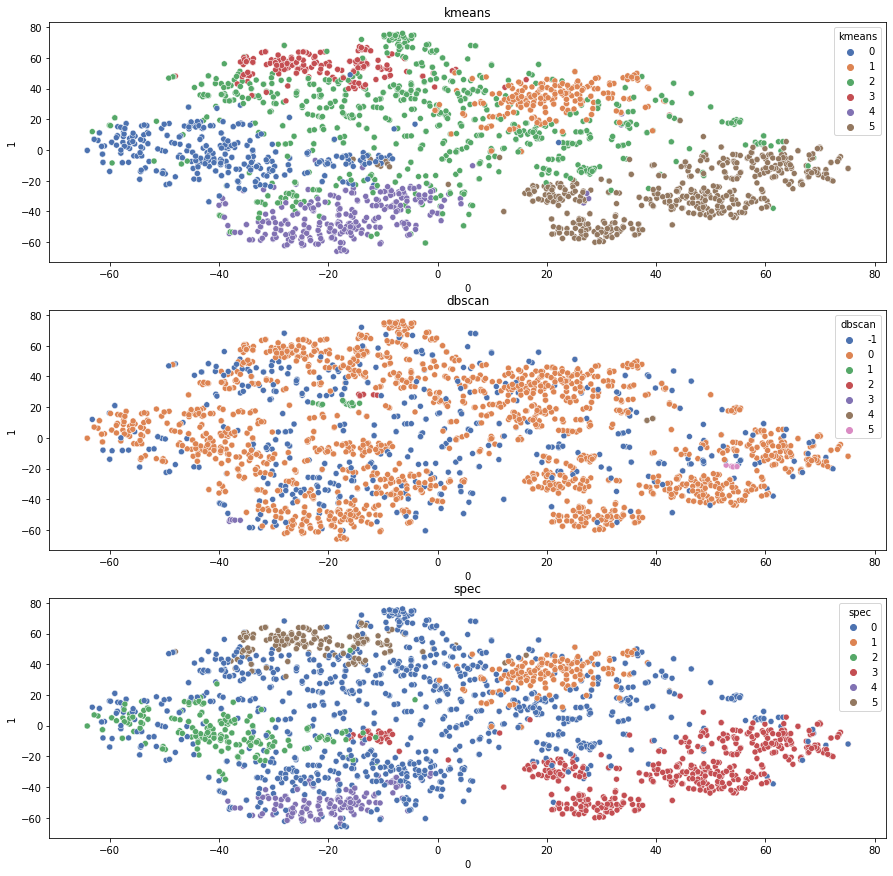

In [43]:
figure, ax = plt.subplots(3,1, figsize=(15,15))
i = 0
for method in ['kmeans','dbscan','spec']:
  sns.scatterplot(x=df[0],y=df[1],hue=df[method],ax=ax[i], palette="deep")
  ax[i].set_title(method)
  i+=1

Прокомментируйте получившиеся результаты. Какой баланс кластеров получился у разных методов? Соотносятся ли визуализации для текстов с визуализациями для географических данных?

**Ответ:**

Kmeans и спектральная кластеризация выдают примерно похожий результат, при этом сильного дисбаланса классов нет, тогда как DBSCAN выдал резултат, где явно присутствует дисбаланс классов (привалируют 0 и -1)).

Как и для географических данных, DBSCAN показал себя плохо. Что касается остальных методов, они идентичны для текстовых данных, в отличие от географических

**Задание 2.4 (1.5 балла).** Обучите модель латентного размещения Дирихле. Не забудьте, что она работает с мешком слов, а не с tf-idf признаками. Придумайте, как превратить распределение тем для текста в номер его кластера. Возьмите параметр `n_components` в 2-3 раза больше, чем число кластеров для K-Means. Получились ли темы более узкими от такого нововведения? Постройте облака тегов для нескольких наиболее удачных тем.

**Ответ:**

In [44]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
from sklearn.decomposition import LatentDirichletAllocation

In [45]:
from sklearn.feature_extraction.text import CountVectorizer

In [46]:
vectorizer = CountVectorizer().fit(data.text)
X = vectorizer.transform(data.text)

In [47]:
dirichle = LatentDirichletAllocation(n_components=12, random_state=0).fit(X)

In [48]:
topics_den = dirichle.transform(X)

In [49]:
names = vectorizer.get_feature_names()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [50]:
components = dirichle.components_

https://machinelearninggeek.com/latent-dirichlet-allocation-using-scikit-learn/

In [51]:
topic_dict = {}
for index, component in enumerate(components):
    zipped = zip(names, component)
    top_terms_key=sorted(zipped, key = lambda t: t[1], reverse=True)[:1000]
    top_terms_list=list(dict(top_terms_key).keys())
    topic_dict["Topic "+str(index)] =top_terms_list

Topic:  0


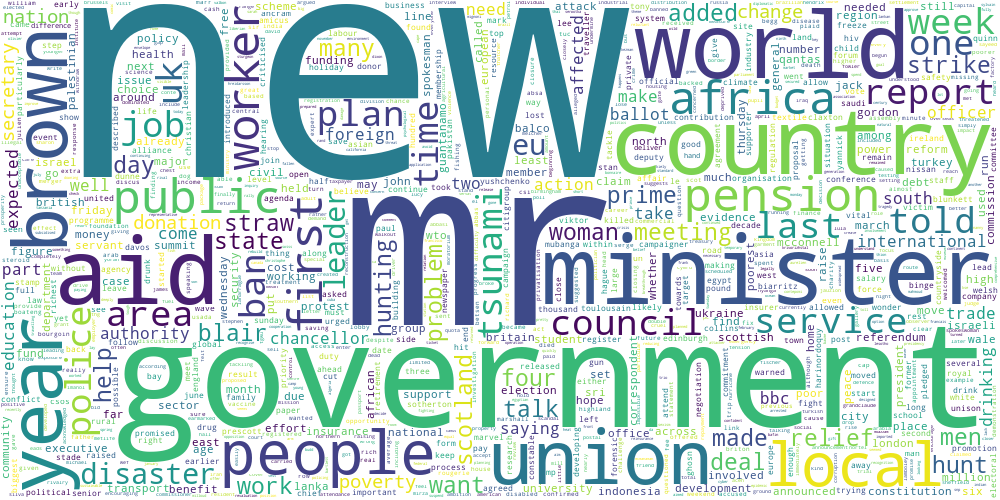

Topic:  1


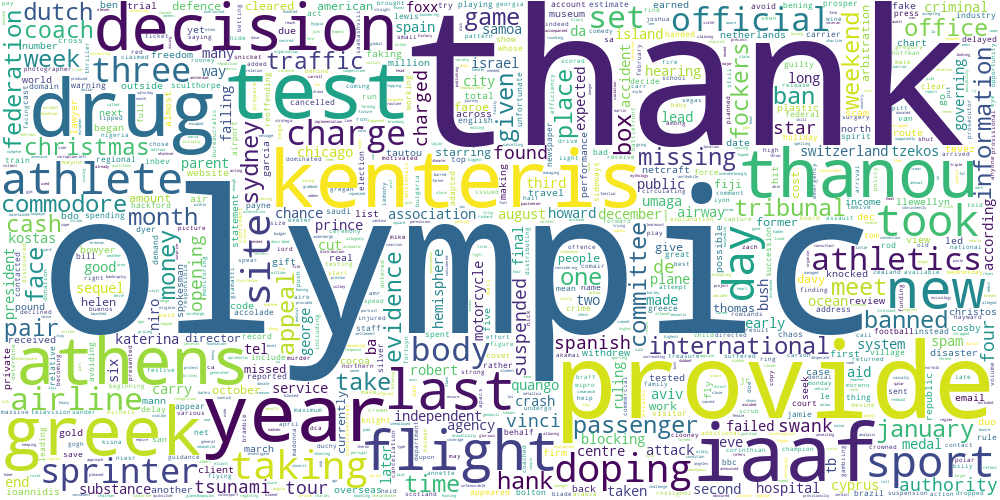

Topic:  2


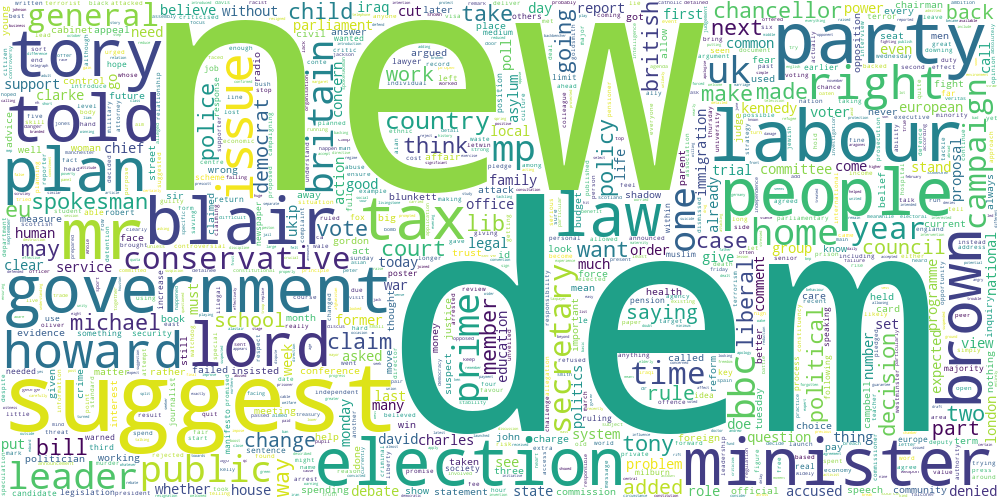

Topic:  3


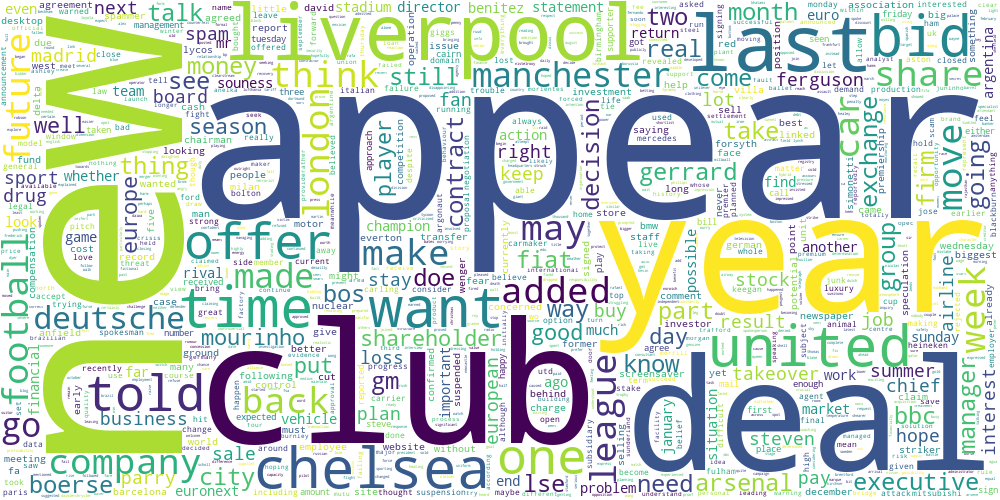

Topic:  4


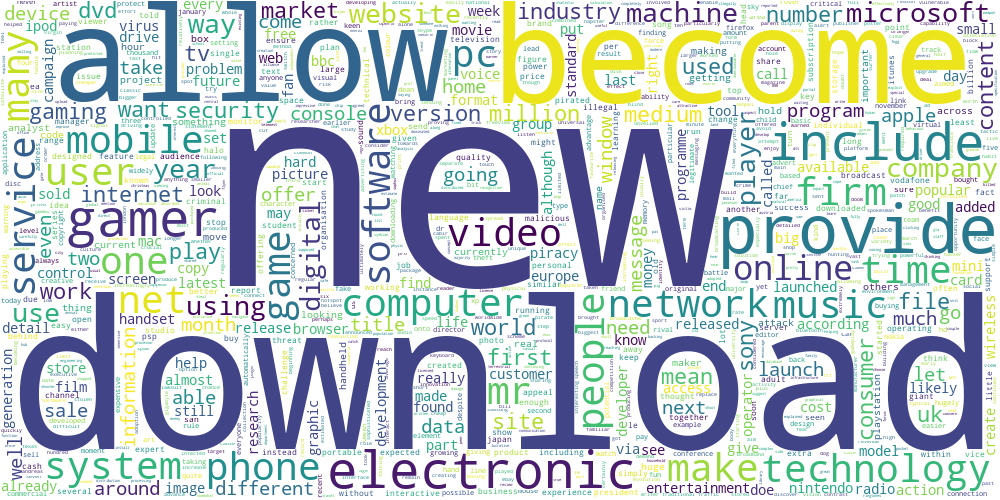

Topic:  5


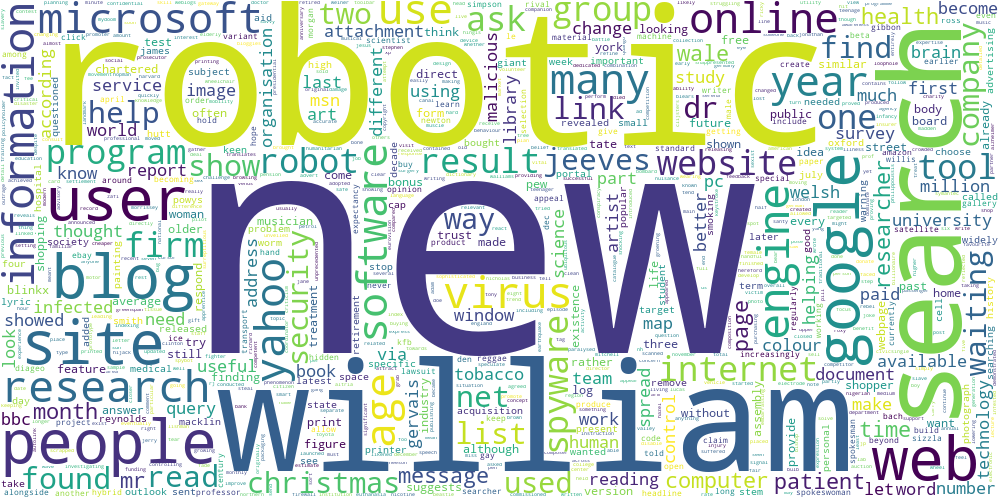

Topic:  6


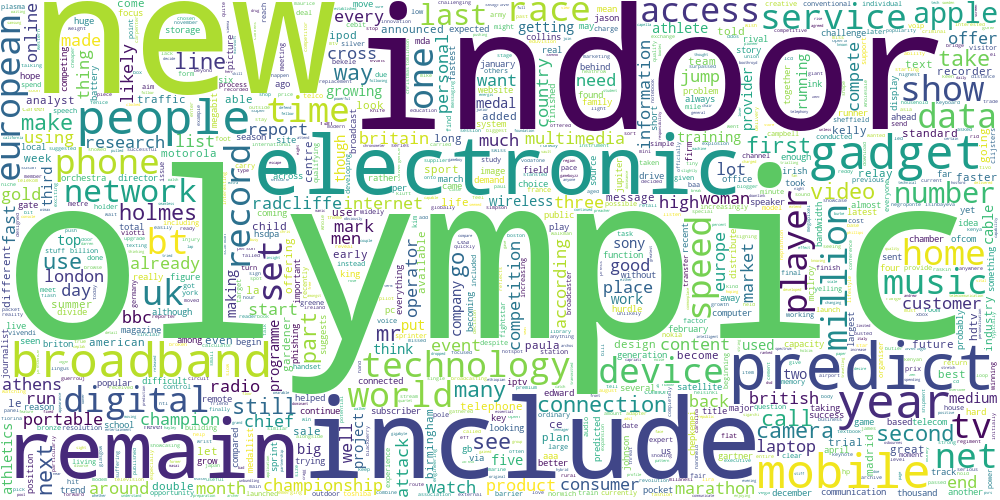

Topic:  7


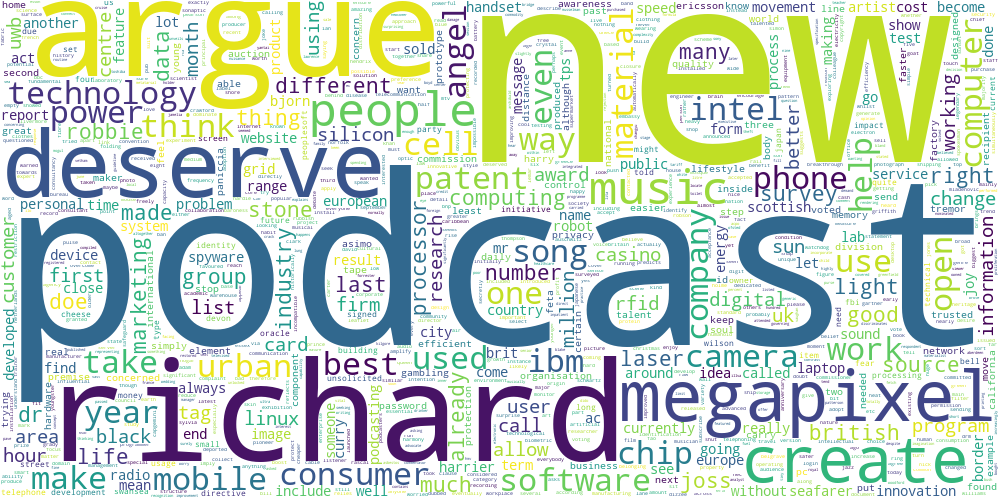

Topic:  8


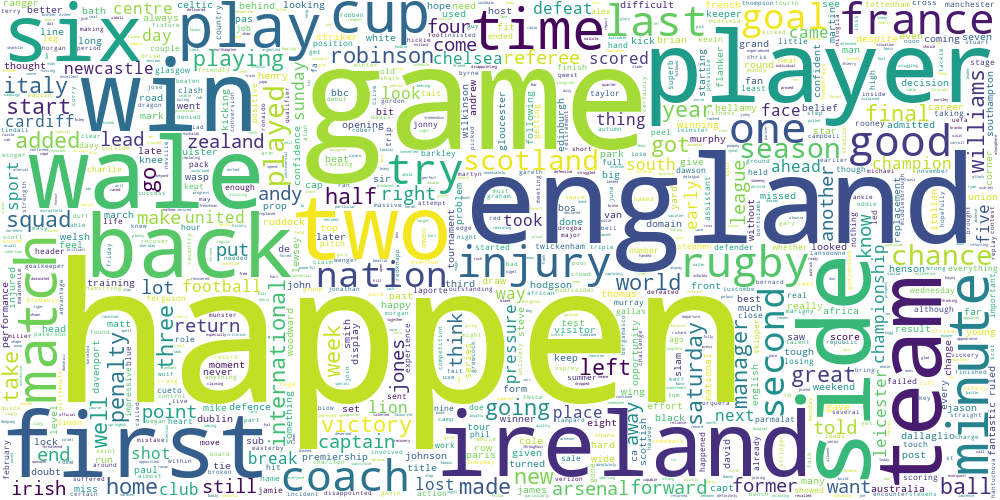

Topic:  9


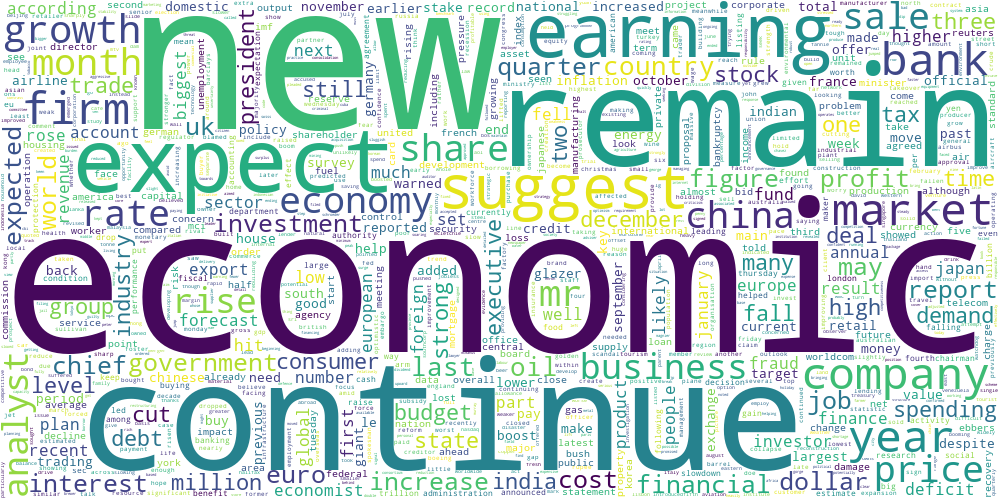

Topic:  10


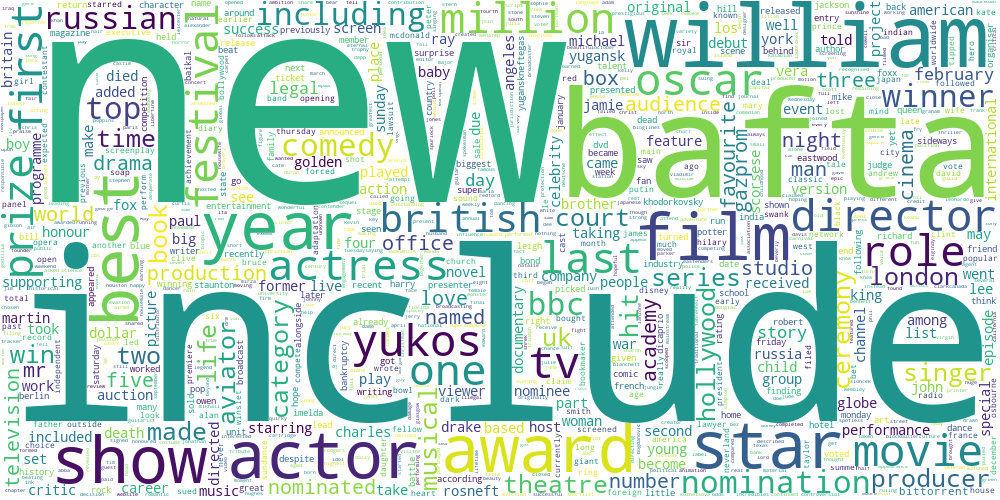

Topic:  11


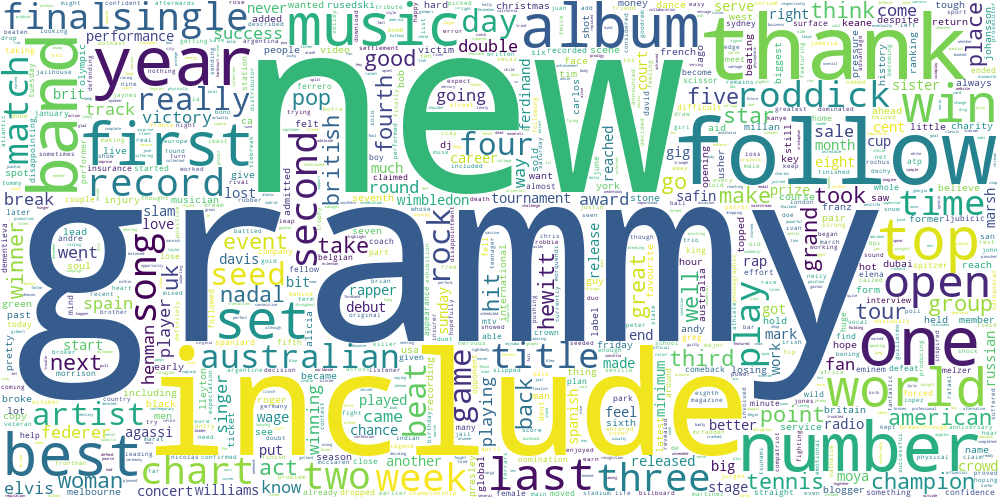

In [52]:
for i in range(12): 
  print('Topic: ',i)
  display(draw_wordcloud(topic_dict['Topic {}'.format(i)]))

In [53]:
pip install pyldavis

     |████████████████████████████████| 1.7 MB 8.8 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
  Created wheel for pyldavis: filename=pyLDAvis-3.3.1-py2.py3-none-any.whl size=136898 sha256=61658fc3ae657a53d5ebb0825b87e7d56099977cf1232f0917e43166193c4baf
  Stored in directory: /root/.cache/pip/wheels/c9/21/f6/17bcf2667e8a68532ba2fbf6d5c72fdf4c7f7d9abfa4852d2f
Successfully built pyldavis


In [54]:
import pyLDAvis.sklearn as sklearnvis
import pyLDAvis

/usr/local/lib/python3.7/dist-packages/past/types/oldstr.py:5: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Iterable
/usr/local/lib/python3.7/dist-packages/past/builtins/misc.py:4: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Mapping


In [55]:
vis = sklearnvis.prepare(dirichle, X, vectorizer)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


In [56]:
pyLDAvis.display(vis)

Как можно увидеть из графика выше, темы действительно получилсиь уже и остались осмысленными

## Часть 3. Transfer learning для задачи классификации текстов

**Задание 3.1 (0.5 балла).** Вспомним, что у нас есть разметка для тематик статей. Попробуем обучить классификатор поверх unsupervised-представлений для текстов. Рассмотрите три модели:

* Логистическая регрессия на tf-idf признаках
* K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров
* Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

Разделите выборку на обучающую и тестовую, замерьте accuracy на обоих выборках для всех трех моделей. Параметры всех моделей возьмите равными значениям по умолчанию.

Логистическая регрессия на tf-idf представлениях

In [57]:
vectorizer = TfidfVectorizer()
X = vectorizer.fit_transform(data.text)

In [58]:
from sklearn.linear_model import LogisticRegression

In [59]:
from sklearn.preprocessing import LabelEncoder

In [60]:
le = LabelEncoder().fit(data['category'])

In [61]:
y = le.transform(data['category'])

In [62]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, shuffle=True, random_state = 0)

In [63]:
lg = LogisticRegression()
lg = lg.fit(X_train, y_train)
pred_tr = lg.predict(X_train)
pred = lg.predict(X_test)

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring(

In [64]:
from sklearn.metrics import accuracy_score

In [66]:
print('accuracy_train:',accuracy_score(y_train,pred_tr))
print('accuracy_test:',accuracy_score(y_test,pred))

accuracy_train: 0.9964028776978417
accuracy_test: 0.9712746858168761


K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

In [67]:
kmeans = KMeans(n_clusters = len(np.unique(y_train)), random_state=0).fit(X)

In [68]:
center = kmeans.cluster_centers_

In [69]:
features = np.zeros((X.shape[0],center.shape[0]))

In [70]:
for i in range(len(center)):
  features[:,i] = np.sqrt(((X.toarray()-center[i])**2).sum(axis=1))

In [71]:
X_train, X_test, y_train, y_test = train_test_split(features,y,shuffle=True, random_state= 0)

In [72]:
lg = LogisticRegression()
lg = lg.fit(X_train, y_train)
pred_tr =lg.predict(X_train)
pred = lg.predict(X_test)

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring(

In [73]:
print('accuracy_train:',accuracy_score(y_train,pred_tr))
print('accuracy_test:',accuracy_score(y_test,pred))

accuracy_train: 0.7931654676258992
accuracy_test: 0.8132854578096947


Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

In [74]:
lda = LatentDirichletAllocation(n_components=len(np.unique(y_train)), random_state=0)
vectorizer = CountVectorizer()
X = vectorizer.fit_transform(data.text)

In [75]:
topic = lda.fit_transform(X)

In [76]:
X_train, X_test, y_train, y_test = train_test_split(topic,y,shuffle=True, random_state= 0)

In [77]:
lg = LogisticRegression()
lg = lg.fit(X_train, y_train)
pred_tr = lg.predict(X_train)
pred = lg.predict(X_test)

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring(

In [78]:
print('accuracy_train:',accuracy_score(y_train,pred_tr))
print('accuracy_test:',accuracy_score(y_test,pred))

accuracy_train: 0.7691846522781774
accuracy_test: 0.7719928186714542


У какой модели получилось лучшее качество? С чем это связано?

**Ответ:**

Лучшая модель - логистическая регрессия на tf-idf представлениях, что логично, поскольку при наличии размеченных данных использование методов, предполагающих предварительную кластеризацию, чревато потерей информации первоначальных данных. В итоге, получается, что обычная логистическая модель на tf-idf признаках использует большее количество доступной информации о данных, нежели другие представленные сочетания моделей. Более того, возможно, что выбранное количество кластеров/компонент также может сказаться на результате, в таком случае, нужно, по-хорошему, подбирать ее как гиперпараметр

**Задание 3.2 (1.5 балла).** Теперь просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 5:65:30. Будем называть части, соответственно, размеченный трейн, неразмеченный трейн и валидация.

Все unsupervised-алгоритмы (векторайзеры и алгоритмы кластеризации) запускайте на всем трейне целиком (размеченном и неразмеченном, суммарно 70%), а итоговый классификатор обучайте только на размеченном трейне (5%). Подберите гиперпараметры моделей по качеству на валидации (30%), а затем оцените качество на тестовой выборке (которая осталась от прошлого задания). Не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации. 

In [ ]:
data['y'] = y

In [ ]:
data = data.drop('kmeans',axis=1)

In [ ]:
X_train, X_test = train_test_split(data, shuffle = True, random_state = True)

In [ ]:
clustering = [None,'kmeans','lda']
vectorizer = [TfidfVectorizer(),CountVectorizer()]
params = {'n_clusters':[6,12,24,48,96],
          'n_components':[6,12,24,48,96]
    }

In [ ]:
from tqdm.auto import tqdm

In [ ]:
class Topic_Modeler():
  def __init__(self, params, cluster='kmeans', vectorizer = TfidfVectorizer()):
    self.cluster = cluster
    self.vectorizer = vectorizer
    self.params = params
  def vectorization(self, text):
    if self.cluster == 'lda':
      self.vectorizer = CountVectorizer()
      text = self.vectorizer.fit_transform(text) 
    else:
      text = self.vectorizer.fit_transform(text) 
    return text
  
  def validation(self, text,y):
    text = self.vectorization(text).toarray()
    labeled_train, unlabeled_train, val = np.split(text,[int(0.05*len(text)), int(0.7*len(text))])
    y_labeled, y_unlabeled, y_val = np.split(y,[int(0.05*len(text)), int(0.7*len(text))])
    accuracy = []
    x_train = np.vstack((labeled_train,unlabeled_train))
    if self.cluster == None:
        lg = LogisticRegression()
        lg = lg.fit(labeled_train, y_labeled)
        pred = lg.predict(val)
        accuracy.append([None,-1,accuracy_score(y_val,pred),self.vectorizer])
    elif self.cluster == 'kmeans':
      for i in self.params['n_clusters']:
        kmeans = KMeans(n_clusters =i, random_state=0).fit(x_train)
        center = kmeans.cluster_centers_
        features = np.zeros((labeled_train.shape[0],center.shape[0]))
        feat_val =  np.zeros((val.shape[0],center.shape[0]))
        for c in range(len(center)):
          features[:,c] = np.sqrt(((labeled_train-center[c])**2).sum(axis=1))
          feat_val[:,c] = np.sqrt(((val-center[c])**2).sum(axis=1))
        lg = LogisticRegression()
        lg = lg.fit(features, y_labeled)
        pred = lg.predict(feat_val)
        accuracy.append(['kmeans',i,accuracy_score(y_val,pred),self.vectorizer])
    elif self.cluster == 'lda':
      for i in self.params['n_components']:
        lda = LatentDirichletAllocation(n_components=i, random_state=0)
        x = lda.fit_transform(x_train)
        val_lda = lda.transform(val)
        lg = LogisticRegression()
        lg = lg.fit(x[:labeled_train.shape[0]], y_labeled)
        pred = lg.predict(val_lda)
        accuracy.append(['lda',i,accuracy_score(y_val,pred),self.vectorizer])
    return accuracy

In [ ]:
results = []
for vec in tqdm(vectorizer):  
  for cl in tqdm(clustering):
    model = Topic_Modeler(cluster=cl, vectorizer=vec, params=params)
    results.extend(model.validation(X_train.text,X_train.y)) 

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring(

  0%|          | 0/3 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring(

In [ ]:
res = np.array(results)

In [ ]:
itog = res[np.argmax(res[:,2])]

In [ ]:
print(itog)

['kmeans' 24 0.8842315369261478 CountVectorizer()]


In [ ]:
vect = CountVectorizer()
text = vect.fit_transform(X_train.text).toarray()
text_test = vect.transform(X_test.text).toarray()
labeled_train, unlabeled_train, val = np.split(text,[int(0.05*len(text)), int(0.7*len(text))])
y_labeled, y_unlabeled, y_val = np.split(X_train.y,[int(0.05*len(text)), int(0.7*len(text))])
model = KMeans(n_clusters =itog[1], random_state=0).fit(np.vstack((labeled_train,unlabeled_train)))
center = model.cluster_centers_
features = np.zeros((labeled_train.shape[0],center.shape[0]))
feat_test =  np.zeros((text_test.shape[0],center.shape[0]))
for c in range(len(center)):
    features[:,c] = np.sqrt(((labeled_train-center[c])**2).sum(axis=1))
    feat_test[:,c] = np.sqrt(((text_test-center[c])**2).sum(axis=1))
lg = LogisticRegression()
lg = lg.fit(features, y_labeled)
pred = lg.predict(feat_test)
print(accuracy_score(X_test.y,pred))

0.881508078994614


/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring(

Как изменились результаты по сравнению с обучением на полной разметке? Сделайте выводы.

**Ответ:**

Accuracy стал меньше, однако теперь лучшие результаты дают модели, преобразованные CountVectorizer-ом и использующие в качестве признаков расстояние до центров кластеров, полученных с помощью KMeans

## Бонус

**Задание 4 (1 балл)**. Разберитесь с semi-supervised методами, которые реализованы в `sklearn` и примените их к заданию 3.2. Получилось ли добиться лучшего качества? Сделайте выводы.

In [ ]:
from sklearn.semi_supervised import SelfTrainingClassifier, LabelPropagation, LabelSpreading

In [ ]:
model = ['SelfTrainingClassifier','LabelPropagation', 'LabelSpreading']
vectorizer = [TfidfVectorizer(),CountVectorizer()]
params = {'estimator':LogisticRegression(),
          'criterion':['threshold', 'k_best'],
          'k_best' :[5,10,20],
          'threshold': [0.33,0.5,0.66,0.75],
          'kernel':['knn', 'rbf'],
          'gamma':[10,20,40],
          'n_neighbors':[5,7,10,20],
          'alpha': [0.2,0.5]
          }

In [ ]:
class Semi_super():
  def __init__(self, vectorizer, model, params):
    self.vectorizer = vectorizer
    self.model = model
    self.params = params
  def vectorization(self, text):
    text = self.vectorizer.fit_transform(text) 
    return text
  
  def validation(self, text, y):
    accuracy = []
    text = self.vectorization(text).toarray()
    labeled_train, unlabeled_train, val = np.split(text,[int(0.05*len(text)), int(0.7*len(text))])
    y_labeled, y_unlabeled, y_val = np.split(y,[int(0.05*len(text)), int(0.7*len(text))])
    y_unlabeled[:]=-1
    x_train = np.vstack((labeled_train, unlabeled_train))
    y_train = np.hstack((y_labeled.to_numpy(), y_unlabeled.to_numpy()))
    if self.model == 'SelfTrainingClassifier':
      for cr in self.params['criterion']:
        if cr == 'threshold':
          for tr in self.params['threshold']:
            self_training_model = SelfTrainingClassifier(self.params['estimator'], criterion = cr, threshold=tr)
            self_training_model.fit(x_train, y_train)
            pred = self_training_model.predict(val)
            accuracy.append([self.model,cr, tr,accuracy_score(y_val,pred),self.vectorizer,None])
        else:
          for k in self.params['k_best']:
            self_training_model = SelfTrainingClassifier(self.params['estimator'], criterion = cr, k_best=k)
            self_training_model.fit(x_train, y_train)
            pred = self_training_model.predict(val)
            accuracy.append([self.model,cr, k,accuracy_score(y_val,pred),self.vectorizer,None])
    elif self.model == 'LabelPropagation':
      for kernel in self.params['kernel']:
        if kernel == 'rbf':
          for gamma in self.params['gamma']:
            label_prop_model = LabelPropagation(kernel=kernel, gamma=gamma)
            label_prop_model.fit(x_train, y_train)
            pred = label_prop_model.predict(val)
            accuracy.append([self.model, kernel, gamma,accuracy_score(y_val,pred),self.vectorizer,None])
        else:
          for n in self.params['n_neighbors']:
            label_prop_model = LabelPropagation(kernel=kernel, n_neighbors=n)
            label_prop_model.fit(x_train, y_train)
            pred = label_prop_model.predict(val)
            accuracy.append([self.model, kernel, n,accuracy_score(y_val,pred),self.vectorizer,None])
    elif self.model == 'LabelSpreading':
      for kernel in self.params['kernel']:
        if kernel == 'rbf':
            for gamma in self.params['gamma']:
              for alpha in self.params['alpha']:
                label_sep_model = LabelSpreading(kernel=kernel, gamma=gamma, alpha = alpha)
                label_sep_model.fit(x_train, y_train)
                pred = label_sep_model.predict(val)
                accuracy.append([self.model, kernel, gamma,accuracy_score(y_val,pred),self.vectorizer,alpha])
        else:
          for n in self.params['n_neighbors']:
            for alpha in self.params['alpha']:
              label_sep_model = LabelSpreading(kernel=kernel, n_neighbors=n, alpha = alpha)
              label_sep_model.fit(x_train, y_train)
              pred = label_sep_model.predict(val)
              accuracy.append([self.model, kernel, n,accuracy_score(y_val,pred),self.vectorizer,alpha])
    return accuracy

In [ ]:
results = []
for vec in tqdm(vectorizer):  
  for cl in tqdm(model): 
    mod = Semi_super(model=cl, vectorizer=vec, params=params)
    results.extend(mod.validation(X_train.text,X_train.y)) 

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

Выходные данные были обрезаны до нескольких последних строк (5000).
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring

  0%|          | 0/3 [00:00<?, ?it/s]

Выходные данные были обрезаны до нескольких последних строк (5000).
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  task_str = task.tostring()
/usr/local/lib/python3.7/dist-packages/scipy/optimize/lbfgsb.py:339: DeprecationWarning: tostring

In [ ]:
res = np.array(results)

In [ ]:
res

array([['SelfTrainingClassifier', 'threshold', 0.33, 0.4431137724550898,
        TfidfVectorizer(), None],
       ['SelfTrainingClassifier', 'threshold', 0.5, 0.18163672654690619,
        TfidfVectorizer(), None],
       ['SelfTrainingClassifier', 'threshold', 0.66, 0.6027944111776448,
        TfidfVectorizer(), None],
       ['SelfTrainingClassifier', 'threshold', 0.75, 0.6027944111776448,
        TfidfVectorizer(), None],
       ['SelfTrainingClassifier', 'k_best', 5, 0.35129740518962077,
        TfidfVectorizer(), None],
       ['SelfTrainingClassifier', 'k_best', 10, 0.29141716566866266,
        TfidfVectorizer(), None],
       ['SelfTrainingClassifier', 'k_best', 20, 0.3093812375249501,
        TfidfVectorizer(), None],
       ['LabelPropagation', 'knn', 5, 0.844311377245509,
        TfidfVectorizer(), None],
       ['LabelPropagation', 'knn', 7, 0.872255489021956,
        TfidfVectorizer(), None],
       ['LabelPropagation', 'knn', 10, 0.8403193612774451,
        TfidfVectorizer(

In [ ]:
itog = res[np.argmax(res[:,3])]

In [ ]:
print(itog)

['LabelSpreading' 'knn' 20 0.9281437125748503 TfidfVectorizer() 0.2]


In [ ]:
vectorizer = TfidfVectorizer()
text = vectorizer.fit_transform(X_train.text).toarray()
text_test = vectorizer.transform(X_test.text).toarray()
labeled_train, unlabeled_train, val = np.split(text,[int(0.05*len(text)), int(0.7*len(text))])
y_labeled, y_unlabeled, y_val = np.split(X_train.y,[int(0.05*len(text)), int(0.7*len(text))])
y_unlabeled[:]=-1
x_train = np.vstack((labeled_train, unlabeled_train))
y_train = np.hstack((y_labeled, y_unlabeled))
label_sep_model = LabelSpreading(kernel='knn', n_neighbors=20, alpha = 0.2)
label_sep_model.fit(x_train, y_train)
pred = label_sep_model.predict(text_test)
print(accuracy_score(X_test.y,pred))

0.9210053859964094


Полчилось добиться лучшего качества.

Вывод:

semi_supervised модели справляются лучше с данными с наличикм слабой разметки, чем описанные выше методы.

**Задание 5 (1 балл)**. На занятиях мы обсуждали, что метрика [BCubed](https://www.researchgate.net/profile/Julio-Gonzalo-2/publication/225548032_Amigo_E_Gonzalo_J_Artiles_J_et_alA_comparison_of_extrinsic_clustering_evaluation_metrics_based_on_formal_constraints_Inform_Retriev_12461-486/links/0c96052138dbb99740000000/Amigo-E-Gonzalo-J-Artiles-J-et-alA-comparison-of-extrinsic-clustering-evaluation-metrics-based-on-formal-constraints-Inform-Retriev-12461-486.pdf) хорошо подходит для сравнения алгоритмов кластеризации, если нам известно настоящее разделение на кластеры (gold standard). Реализуйте подсчет метрики BCubed и сравните несколько алгоритмов кластеризации на текстовых данных из основного задания. В качестве gold standard используйте разметку category.

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
def correctness(y,labels):
  return (y[:,None] == y)*(labels[:,None] == labels)

In [ ]:
def precision_b_cubed(correctness, labels):
  l = (labels[:,None] == labels)*1
  return np.mean(np.sum(np.where(l==1, correctness, 0),axis=1)/np.sum(l==1,axis=1))

In [ ]:
def recall_b_cubed(correctness, y):
  l = (y[:,None] == y)
  return np.mean(np.sum(np.where(l==1, correctness, 0),axis=1)/np.sum(l==1,axis=1))

In [ ]:
def F_b_cubed(precison_b_cubed, recall_b_cubed):
  return 2*(precison_b_cubed*recall_b_cubed)/(precison_b_cubed+recall_b_cubed)

In [ ]:
vectorizer = TfidfVectorizer()
X = vectorizer.fit_transform(data['text'])

In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
le = LabelEncoder().fit(data['category'])

In [ ]:
y = le.transform(data['category'])

In [ ]:
from sklearn.cluster import SpectralClustering

In [ ]:
spec = SpectralClustering(n_clusters=6).fit(X).labels_

In [ ]:
print('precision_b_cubed: ',precision_b_cubed(correctness(y,spec), spec))
print('recall_b_cubed: ',recall_b_cubed(correctness(y,spec), y))
print('F_b_cubed: ',F_b_cubed(precision_b_cubed(correctness(y,spec), spec),recall_b_cubed(correctness(y,spec), y)))

precision_b_cubed:  0.6132459553329584
recall_b_cubed:  0.5741406385818003
F_b_cubed:  0.5930493509140076


**Задание 6 (2 баллa)**. Спектральная кластеризация, по сути, является обычной кластеризацией KMeans поверх эмбеддингов объектов, которые получаются из лапласиана графа. А что, если мы попробуем построить эмбеддинги каким-нибудь другим способом? В этом задании мы предлагаем вам проявить немного фантазии. Возьмите какие-нибудь данные высокой размерности, чтобы задача обучения эмбеддингов имела смысл (например, картинки или тексты, желательно выбрать что-нибудь оригинальное). Придумайте или найдите какой-нибудь метод обучения эмбеддингов, примените его к данным и кластеризуйте полученные представления. Если чувствуете в себе достаточно силы, можете попробовать что-нибудь нейросетевое. Сравните ваш подход с базовыми алгоритмами кластеризации, которое мы рассмотрели в основном задании, не забывайте про визуализации! Ключевые слова для вдохновения: ***KernelPCA***, ***UMAP***, ***autoencoders***, ***gensim***. 

Буду строить модели на тех же текстовых данных, что и раньше

In [ ]:
from gensim.models import FastText

In [ ]:
text = data.text.apply(lambda x: x.split(' ')).tolist()

In [ ]:
model = FastText(sentences=text, size = 100, window = 5)

/usr/local/lib/python3.7/dist-packages/gensim/models/fasttext.py:383: DeprecationWarning: Call to deprecated `bucket` (Attribute will be removed in 4.0.0, use trainables.bucket instead).
  self.wv.bucket = self.bucket
/usr/local/lib/python3.7/dist-packages/gensim/models/fasttext.py:522: DeprecationWarning: Call to deprecated `layer1_size` (Attribute will be removed in 4.0.0, use self.trainables.layer1_size instead).
  l1_size = self.layer1_size * np.dtype(np.float32).itemsize
/usr/local/lib/python3.7/dist-packages/gensim/models/fasttext.py:526: DeprecationWarning: Call to deprecated `bucket` (Attribute will be removed in 4.0.0, use trainables.bucket instead).
  num_buckets = self.bucket


In [ ]:
wv = model.wv

In [ ]:
from tqdm.auto import tqdm

In [ ]:
n = []
for k in tqdm(range(len(data))):
  lis = []
  for i in np.array(data.text[k].split(' ')):
    if i in wv.vocab:
      lis.append(wv.vocab[i])
  sample = model[lis].reshape(1,-1)[0]
  if len(sample)<150000:
    sample = np.append(sample,np.zeros(150000-len(sample)))
  n.append(sample[:150000])

  0%|          | 0/2225 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys


In [ ]:
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import TfidfVectorizer

In [ ]:
x_fast_text = np.array(n)

In [ ]:
km_fast = KMeans(n_clusters = 5)

In [ ]:
labels_fast = km_fast.fit(x_fast_text).labels_

In [ ]:
tf = TfidfVectorizer()
x_base = tf.fit_transform(data.text)

In [ ]:
km_base = KMeans(n_clusters = 5)
labels_base = km_base.fit(x_base).labels_

In [ ]:
from sklearn.decomposition import KernelPCA
import matplotlib.pyplot as plt

In [ ]:
pca = KernelPCA(n_components=2,kernel='rbf')

In [ ]:
trans_fast = pca.fit_transform(x_fast_text)
trans_base = pca.fit_transform(x_base)

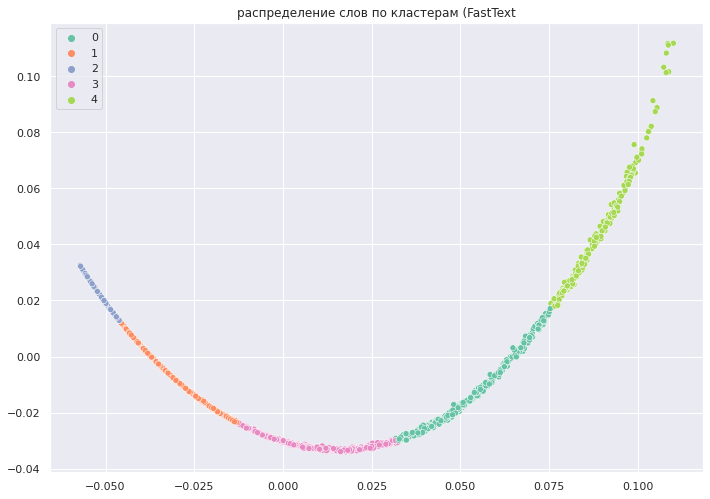

In [ ]:
fig,ax = plt.subplots()
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.scatterplot(
x=trans_fast[:,0], y=trans_fast[:,1], hue=labels_fast, palette='Set2');
ax.set_title('распределение слов по кластерам (FastText');

In [ ]:
print("Для FastText")
print('precision_b_cubed: ',precision_b_cubed(correctness(y,labels_fast), labels_fast))
print('recall_b_cubed: ',recall_b_cubed(correctness(y,labels_fast), y))
print('F_b_cubed: ',F_b_cubed(precision_b_cubed(correctness(y,labels_fast), labels_fast),recall_b_cubed(correctness(y,labels_fast), y)))

Для FastText
precision_b_cubed:  0.24709678282928427
recall_b_cubed:  0.25910551794041636
F_b_cubed:  0.2529587076117238


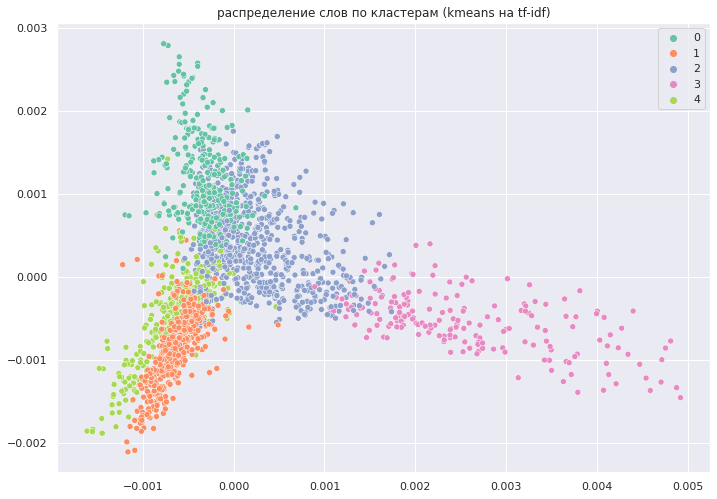

In [ ]:
fig,ax = plt.subplots()
sns.set(rc={'figure.figsize':(11.7,8.27)})
sns.scatterplot(x=trans_base[:,0], y=trans_base[:,1], hue=labels_base, palette='Set2');
ax.set_title('распределение слов по кластерам (kmeans на tf-idf)');

In [ ]:
print('kmeans на tf-idf')
print('precision_b_cubed: ',precision_b_cubed(correctness(y,labels_base), labels_base))
print('recall_b_cubed: ',recall_b_cubed(correctness(y,labels_base), y))
print('F_b_cubed: ',F_b_cubed(precision_b_cubed(correctness(y,labels_base), labels_base),recall_b_cubed(correctness(y,labels_base), y)))

kmeans на tf-idf
precision_b_cubed:  0.7449550130289717
recall_b_cubed:  0.7737241246760701
F_b_cubed:  0.7590670748923374


Базовый алгоритм ортаботал лучше, чем Kmeans на признаках полученных с помощью FastText